In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings

In [ ]:
!git clone https://github.com/Rohan-J123/PyroPredictorModel

Cloning into 'PyroPredictorModel'...
remote: Enumerating objects: 332, done.
remote: Counting objects: 100% (332/332), done.
remote: Compressing objects: 100% (102/102), done.
remote: Total 332 (delta 257), reused 300 (delta 228), pack-reused 0 (from 0)
Receiving objects: 100% (332/332), 26.91 MiB | 12.86 MiB/s, done.
Resolving deltas: 100% (257/257), done.


In [ ]:
forest_fires = pd.read_csv('/content/PyroPredictorModel/Forest_Fires.csv')

no_fires = pd.read_csv('/content/PyroPredictorModel/No_Fires_Larger.csv')

combined_dataset = pd.concat([forest_fires, no_fires], ignore_index=True)
shuffled_dataset = combined_dataset.sample(frac=1, random_state=42).reset_index(drop=True)

dataset = shuffled_dataset
print(dataset.head())

   longitude   latitude  month  severity  ndvi   evi  lai  fpar  elevation  \
0  71.550597  24.871731      9         0  5985  4295   17    63       28.0   
1  75.363980  13.461610      1         0  8446  3742   54    89      762.0   
2  83.352281  23.738874      3      9280  4895  2702   13    45      526.0   
3  74.730360  28.394917      3         0  1981  1293    2    16      268.0   
4  74.356150  22.621312      2         0  2919  1308    4    25      452.0   

   relative_humidity  ...  surface_pressure  cloud_cover  wind_speed  \
0          71.660515  ...       1005.029968    64.208336    6.318307   
1          61.519329  ...        928.305969    22.541666    6.720856   
2          33.725258  ...        948.428894    19.625000    7.875883   
3          66.151947  ...        985.133850    18.875000   11.952470   
4          50.998199  ...        961.282898     1.583333    8.598405   

   soil_temperature  soil_moisture  direct_radiation  weather_code  \
0         31.577667       0.

In [ ]:
dataset.shape

(1995, 21)

In [ ]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1995 entries, 0 to 1994
Data columns (total 21 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           1995 non-null   float64
 1   latitude            1995 non-null   float64
 2   month               1995 non-null   int64  
 3   severity            1995 non-null   int64  
 4   ndvi                1995 non-null   int64  
 5   evi                 1995 non-null   int64  
 6   lai                 1995 non-null   int64  
 7   fpar                1995 non-null   int64  
 8   elevation           1995 non-null   float64
 9   relative_humidity   1995 non-null   float64
 10  dew_point           1995 non-null   float64
 11  surface_pressure    1995 non-null   float64
 12  cloud_cover         1995 non-null   float64
 13  wind_speed          1995 non-null   float64
 14  soil_temperature    1995 non-null   float64
 15  soil_moisture       1995 non-null   float64
 16  direct

In [ ]:
cat_data = dataset.select_dtypes('object').columns.to_list()
num_data = dataset.columns.to_list()
for col in cat_data:
    num_data.remove(col)
num_data.remove('severity')
print('the categoraical columns in the dataset is: ', cat_data)
print('the numerical columns in the dataset is: ', num_data)

the categoraical columns in the dataset is:  []
the numerical columns in the dataset is:  ['longitude', 'latitude', 'month', 'ndvi', 'evi', 'lai', 'fpar', 'elevation', 'relative_humidity', 'dew_point', 'surface_pressure', 'cloud_cover', 'wind_speed', 'soil_temperature', 'soil_moisture', 'direct_radiation', 'weather_code', 'temperature', 'precipitation', 'evapotranspiration']


In [ ]:
dataset.isna().sum()

,0
longitude,0
latitude,0
month,0
severity,0
ndvi,0
evi,0
lai,0
fpar,0
elevation,0
relative_humidity,0


In [ ]:
dataset.duplicated().sum()

1

In [ ]:
dataset[dataset.duplicated()]

,longitude,latitude,month,severity,ndvi,evi,lai,fpar,elevation,relative_humidity,...,surface_pressure,cloud_cover,wind_speed,soil_temperature,soil_moisture,direct_radiation,weather_code,temperature,precipitation,evapotranspiration
1728,92.665568,22.543152,3,13624,7280,4322,55,89,467.0,47.410889,...,963.324524,0.208333,5.220674,19.834585,0.171708,180.5,0.0,21.490831,0.0,4.512396


In [ ]:
data_no_dup = dataset.copy()
data_no_dup.drop_duplicates(inplace = True)
data_no_dup[data_no_dup.duplicated()]

,longitude,latitude,month,severity,ndvi,evi,lai,fpar,elevation,relative_humidity,...,surface_pressure,cloud_cover,wind_speed,soil_temperature,soil_moisture,direct_radiation,weather_code,temperature,precipitation,evapotranspiration


In [ ]:
data_no_dup.describe()

,longitude,latitude,month,severity,ndvi,evi,lai,fpar,elevation,relative_humidity,...,surface_pressure,cloud_cover,wind_speed,soil_temperature,soil_moisture,direct_radiation,weather_code,temperature,precipitation,evapotranspiration
count,1994.000000,1994.000000,1994.000000,1994.000000,1994.000000,1994.000000,1994.000000,1994.000000,1994.000000,1994.000000,...,1994.000000,1994.000000,1994.000000,1994.000000,1994.000000,1994.000000,1994.000000,1994.000000,1994.000000,1994.000000
mean,78.645930,24.656056,5.748746,3157.706118,4154.101805,2564.755767,10.327482,36.353561,500.236710,56.448594,...,956.560688,34.302658,9.360868,25.874537,0.206656,146.275054,19.755767,24.435554,2.082949,4.956032
std,6.335140,5.210203,3.279972,8479.097015,2004.938918,1327.721225,12.582276,21.920782,835.367113,21.660774,...,78.902462,33.430558,4.328240,7.984745,0.125747,53.463725,26.468037,8.090096,7.051457,2.033992
min,55.240717,-21.025910,1.000000,0.000000,-1059.000000,-603.000000,1.000000,2.000000,0.000000,9.988723,...,510.198212,0.000000,1.530772,-14.089667,0.000000,0.750000,0.000000,-25.333418,0.000000,0.569586
25%,74.248099,22.876920,3.000000,0.000000,2535.000000,1585.000000,3.000000,18.000000,162.250000,38.080568,...,961.340485,4.125000,6.392405,22.195644,0.132000,115.687500,1.000000,21.386978,0.000000,3.493385
50%,76.324202,25.734189,5.000000,0.000000,3901.000000,2289.500000,6.000000,32.000000,286.000000,57.024216,...,976.881531,22.458334,8.455676,27.273833,0.180813,148.437500,3.000000,26.344166,0.000000,4.603172
75%,82.074907,27.112747,9.000000,5096.500000,5690.500000,3375.500000,12.000000,50.000000,424.000000,75.610910,...,990.747559,61.354167,11.288062,30.820792,0.281313,186.489582,51.000000,29.266792,0.400000,6.292572
max,96.654579,36.490083,12.000000,153484.000000,9452.000000,8203.000000,70.000000,100.000000,5569.000000,98.974373,...,1017.567200,100.000000,30.433020,41.903584,0.754083,343.916656,75.000000,39.232746,89.200005,13.282063


In [ ]:
data_no_dup['log-area'] = np.log10(data_no_dup['severity'] + 1)

<ipython-input-13-ffa0250f99df>:2: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared.
  data_no_dup.hist(ax=ax)  # Pass ax to hist() to control which axes the plot goes to


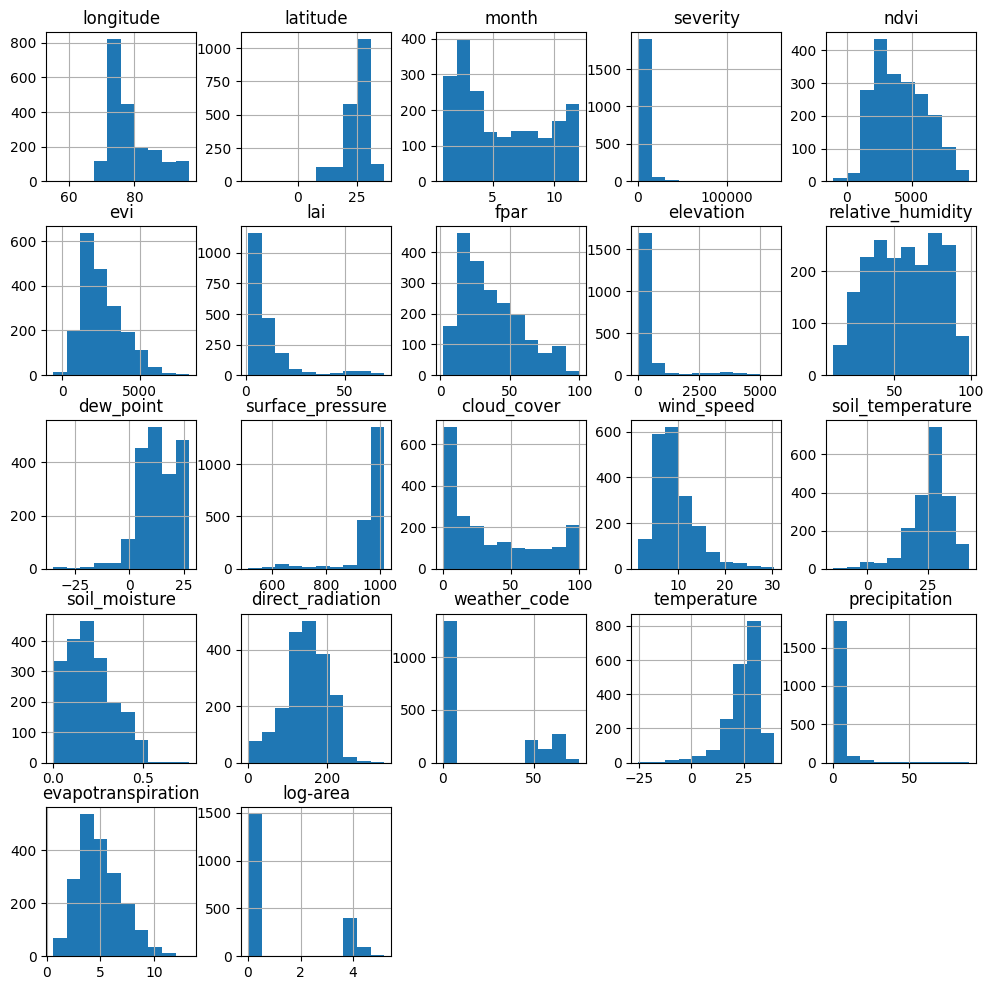

In [ ]:
fig, ax = plt.subplots(figsize=(12, 12))  # Create figure and axis
data_no_dup.hist(ax=ax)  # Pass ax to hist() to control which axes the plot goes to
fig.savefig('/content/plot.png')  # Save the figure explicitly

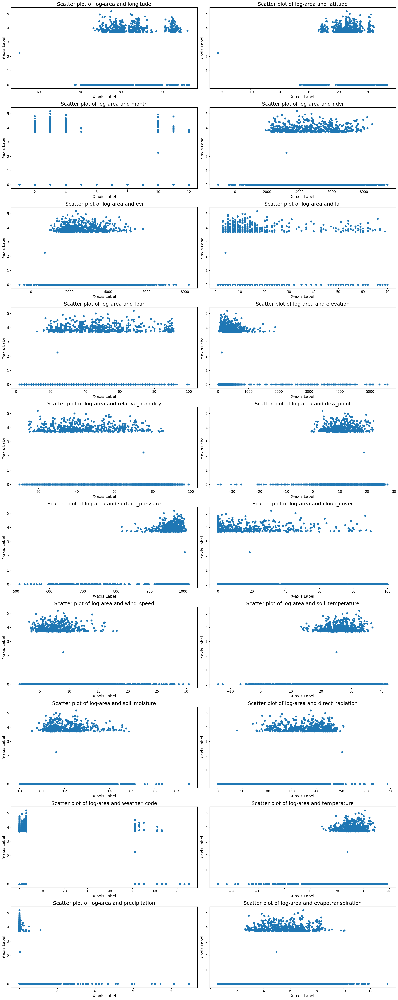

In [ ]:
# Assuming data_no_dup[num_data].columns has the column names you want to plot
num_plots = len(data_no_dup[num_data].columns)  # Number of subplots you want to create

# Calculate the required rows and columns based on the number of subplots
rows = (num_plots + 1) // 2  # Each row will have 2 subplots (if possible)
cols = 2

# Create a figure with the appropriate size
plt.figure(figsize=(20, rows * 5))

# Loop through columns and create subplots
for i, col in enumerate(data_no_dup[num_data].columns, 1):
    plt.subplot(rows, cols, i)

    # Title with increased font size
    plt.title(f'Scatter plot of log-area and {col}', fontsize=18)

    # Scatter plot
    plt.scatter(data_no_dup[col], data_no_dup['log-area'])

    # Increase axis labels font size
    plt.xlabel('X-axis Label', fontsize=14)  # You can modify the label text if needed
    plt.ylabel('Y-axis Label', fontsize=14)  # Modify this as well if you have custom labels

    # Increase font size of tick labels
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)

# Adjust layout to prevent overlap
plt.tight_layout()

# Save the figure before showing it
plt.savefig('./ScatterPlot.png')

# Show the plot
plt.show()

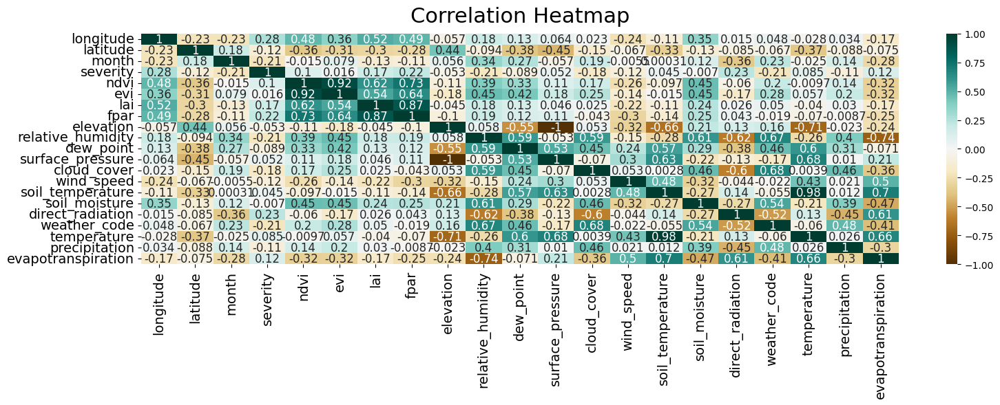

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(16, 6))

# Create heatmap
heatmap = sns.heatmap(
    dataset.corr(),
    vmin=-1, vmax=1,
    annot=True,
    cmap='BrBG',
    annot_kws={"size": 12}  # Increase the size of the annotations
)

# Increase title font size
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize': 22}, pad=12)

# Increase x and y tick labels font size
heatmap.set_xticklabels(heatmap.get_xticklabels(), fontsize=14)
heatmap.set_yticklabels(heatmap.get_yticklabels(), fontsize=14)

# Adjust the layout to avoid clipping
plt.tight_layout()

# Save the heatmap
plt.savefig('/content/heatmap.png')

# Show the plot
plt.show()

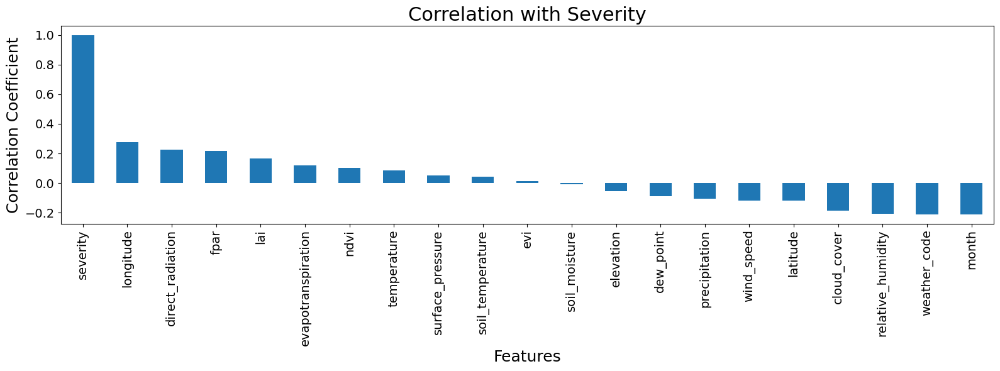

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(16, 6))

# Create the bar plot
dataset.corr()['severity'].sort_values(ascending=False).plot(kind='bar')

# Increase the font size of the title, axis labels, and tick labels
plt.title('Correlation with Severity', fontsize=22)
plt.xlabel('Features', fontsize=18)
plt.ylabel('Correlation Coefficient', fontsize=18)

# Increase the font size of the x and y tick labels
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

# Adjust the layout to avoid clipping
plt.tight_layout()

# Save the figure
plt.savefig('/content/correlation.png')

# Show the plot
plt.show()

Skew: 6.667844327422843
Kurtosis: 75.54421831041905


<ipython-input-17-155f866c4214>:6: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  ax = sns.kdeplot(data_no_dup['severity'],shade = True, color = 'g')


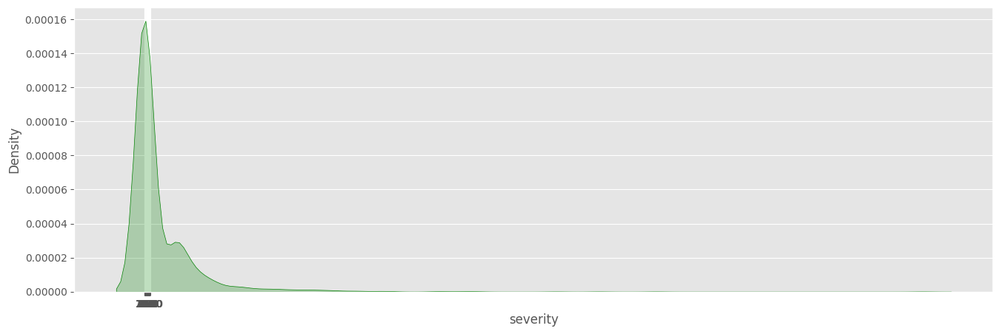

In [ ]:
plt.style.use('ggplot')
plt.rcParams["figure.figsize"] = 9,5
plt.figure(figsize = (16, 5))
print("Skew: {}".format(data_no_dup['severity'].skew()))
print("Kurtosis: {}".format(data_no_dup['severity'].kurtosis()))
ax = sns.kdeplot(data_no_dup['severity'],shade = True, color = 'g')
plt.xticks([i for i in range(0, 1200, 50)])
plt.show()

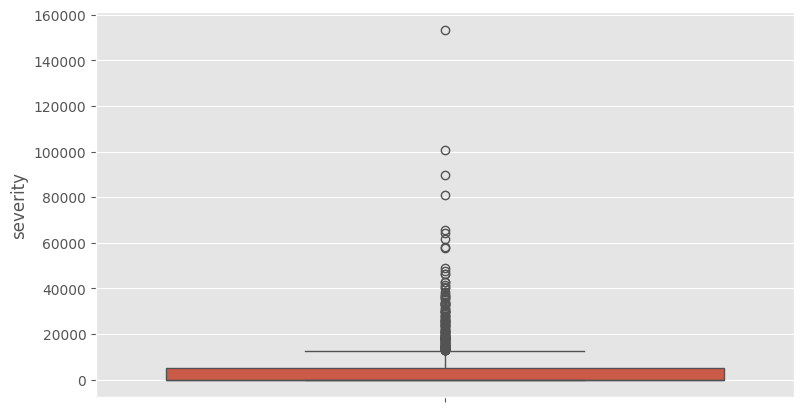

In [ ]:
ax = sns.boxplot(data_no_dup['severity'])

In [ ]:
from scipy.stats import zscore
y_outliers = data_no_dup[abs(zscore(data_no_dup['severity'])) >= 3 ]
y_outliers

,longitude,latitude,month,severity,ndvi,evi,lai,fpar,elevation,relative_humidity,...,cloud_cover,wind_speed,soil_temperature,soil_moisture,direct_radiation,weather_code,temperature,precipitation,evapotranspiration,log-area
97,84.391306,23.603080,3,33400,4625,2709,12,49,557.0,33.336349,...,8.250000,8.653043,28.304001,0.158458,225.500000,3.0,28.108170,0.0,6.741423,4.523759
109,84.067013,20.591680,3,33106,5996,2874,20,65,608.0,37.934612,...,14.041667,9.325336,30.345083,0.135000,159.000000,2.0,28.982576,0.0,6.029507,4.519920
152,79.911014,22.391410,10,29996,4522,2987,14,54,444.0,53.412426,...,0.000000,6.762753,25.921747,0.334708,191.583328,0.0,23.598833,0.0,4.790039,4.477078
160,84.373529,23.610602,3,37353,4835,2197,12,49,635.0,33.388111,...,8.541667,9.550330,27.942169,0.166250,226.875000,3.0,27.873419,0.0,6.876603,4.572337
177,77.354421,22.521873,3,38463,4310,2754,10,44,296.0,20.901039,...,16.208334,7.812822,32.424999,0.247000,193.916672,3.0,30.220839,0.0,6.860553,4.585054
276,82.336121,23.661005,3,100917,4744,2422,11,46,585.0,38.744740,...,45.708332,9.063243,28.532084,0.161792,218.291672,3.0,28.219587,0.0,6.568662,5.003969
285,83.967723,25.152857,4,47583,2402,1788,7,31,84.0,27.521973,...,0.000000,11.142036,33.245747,0.137000,212.416672,0.0,32.349918,0.0,8.323747,4.677461
452,83.960479,25.146114,4,41613,2491,1602,5,29,85.0,28.500818,...,63.000000,9.202760,30.835083,0.156542,152.708328,3.0,29.247580,0.0,6.904863,4.619239
479,77.412061,22.521648,3,61624,4189,2596,9,49,305.0,20.887049,...,16.208334,7.812822,32.366501,0.247000,193.916672,3.0,30.162333,0.0,6.854926,4.789757
492,84.355933,23.621168,3,42912,4490,2500,11,47,532.0,32.199539,...,6.541667,8.772419,28.162666,0.177333,223.500000,3.0,27.775167,0.0,6.732823,4.632589


In [ ]:
data_no_dup = data_no_dup[abs(zscore(data_no_dup['severity'])) < 3]

# Display the new DataFrame without outliers
print(data_no_dup)

      longitude   latitude  month  severity  ndvi   evi  lai  fpar  elevation  \
0     71.550597  24.871731      9         0  5985  4295   17    63       28.0   
1     75.363980  13.461610      1         0  8446  3742   54    89      762.0   
2     83.352281  23.738874      3      9280  4895  2702   13    45      526.0   
3     74.730360  28.394917      3         0  1981  1293    2    16      268.0   
4     74.356150  22.621312      2         0  2919  1308    4    25      452.0   
...         ...        ...    ...       ...   ...   ...  ...   ...        ...   
1990  75.813492  28.453199     10         0  3462  2178   17    68      267.0   
1991  77.372722  26.434935      3         0  3612  1841    7    32      238.0   
1992  76.747863  10.664775      1         0  7289  3971   13    59      123.0   
1993  75.464085  27.935366      1         0  4061  2474    6    43      385.0   
1994  74.067176  26.642056     12         0  3708  2177    5    27      312.0   

      relative_humidity  ..

<ipython-input-21-4cda5bdf003a>:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_no_dup[col], color = 'g', shade = True)
<ipython-input-21-4cda5bdf003a>:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_no_dup[col], color = 'g', shade = True)
<ipython-input-21-4cda5bdf003a>:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_no_dup[col], color = 'g', shade = True)
<ipython-input-21-4cda5bdf003a>:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_no_dup[col], color = 'g', shade = True)


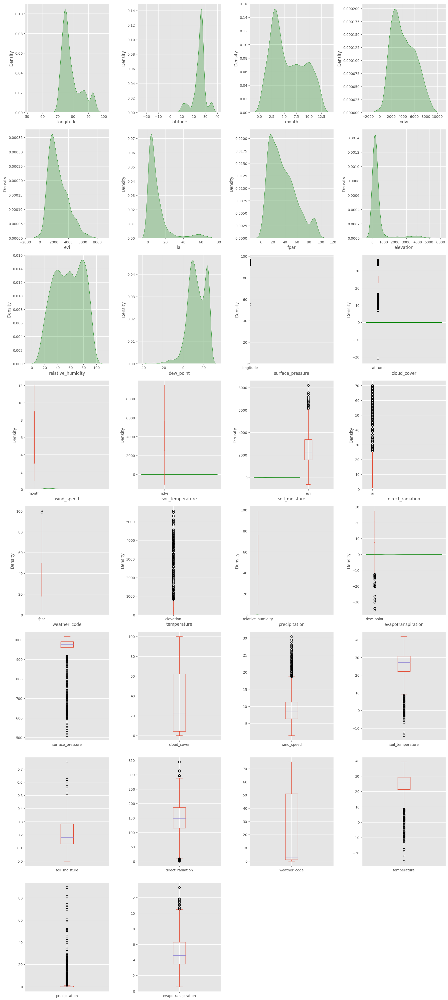

,longitude,latitude,month,ndvi,evi,lai,fpar,elevation,relative_humidity,dew_point,surface_pressure,cloud_cover,wind_speed,soil_temperature,soil_moisture,direct_radiation,weather_code,temperature,precipitation,evapotranspiration
skewness,1.043044,-1.216671,0.376574,0.350973,0.843148,2.751003,0.768924,3.521981,-0.097104,-0.848443,-3.300562,0.667656,1.325043,-1.163379,0.507319,-0.341937,0.785536,-1.818034,6.217611,0.612170
kurtosis,0.170822,4.438616,-1.118665,-0.736817,0.458931,7.786926,-0.155534,12.229838,-1.118622,1.956627,10.645192,-0.975689,2.497968,2.183520,-0.260688,0.024615,-1.281053,5.070702,50.196161,0.096846


In [ ]:
plt.figure(figsize = (18, 40))

for i, col in enumerate(num_data, 1):
    plt.subplot(8, 4, i)
    sns.kdeplot(data_no_dup[col], color = 'g', shade = True)
    plt.subplot(8, 4, i + 10)
    data_no_dup[col].plot.box()

plt.tight_layout()
plt.show()
nums = data_no_dup[num_data]
pd.DataFrame(data=[nums.skew(), nums.kurtosis()], index = ['skewness', 'kurtosis'])

In [ ]:
print(data_no_dup['severity'].describe(), '\n')
print(y_outliers)

count     1955.000000
mean      2284.318670
std       4772.695106
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max      28570.000000
Name: severity, dtype: float64 

      longitude   latitude  month  severity  ndvi   evi  lai  fpar  elevation  \
97    84.391306  23.603080      3     33400  4625  2709   12    49      557.0   
109   84.067013  20.591680      3     33106  5996  2874   20    65      608.0   
152   79.911014  22.391410     10     29996  4522  2987   14    54      444.0   
160   84.373529  23.610602      3     37353  4835  2197   12    49      635.0   
177   77.354421  22.521873      3     38463  4310  2754   10    44      296.0   
276   82.336121  23.661005      3    100917  4744  2422   11    46      585.0   
285   83.967723  25.152857      4     47583  2402  1788    7    31       84.0   
452   83.960479  25.146114      4     41613  2491  1602    5    29       85.0   
479   77.412061  22.521648      3     61624  4189  2596    9  

In [ ]:
def area_cat(area):
    if area == 0.0:
        return "No damage"
    elif area <= 10000:
        return "low"
    elif area <= 25000:
        return "moderate"
    elif area <= 60000:
        return "high"
    else:
        return "very high"

data_no_dup['damage_category'] = data_no_dup['severity'].apply(area_cat)
data_no_dup.sample(15)

,longitude,latitude,month,severity,ndvi,evi,lai,fpar,elevation,relative_humidity,...,wind_speed,soil_temperature,soil_moisture,direct_radiation,weather_code,temperature,precipitation,evapotranspiration,log-area,damage_category
920,79.432476,14.098315,4,12740,5330,2620,16,51,481.0,66.772331,...,8.854471,30.039251,0.158250,220.750000,0.0,27.060083,0.000000,5.854212,4.105204,moderate
459,76.304931,9.603358,6,0,7440,4384,12,43,13.0,85.130402,...,7.805525,27.221502,0.268417,117.791664,53.0,26.011080,2.100000,3.597198,0.000000,No damage
871,76.798135,26.314542,9,0,6749,5441,8,43,289.0,89.997437,...,9.180232,28.018166,0.413542,34.750000,63.0,26.947334,10.200000,2.367879,0.000000,No damage
1772,75.632173,28.038921,9,0,7181,5370,32,78,383.0,65.325951,...,8.816783,31.199417,0.117625,162.125000,3.0,29.830666,0.000000,5.065428,0.000000,No damage
1374,76.814243,27.312876,8,0,7619,7174,15,54,240.0,67.388435,...,14.060079,30.933416,0.329667,164.875000,3.0,30.333420,0.000000,6.013253,0.000000,No damage
206,78.952573,29.897703,4,5350,4955,2786,15,51,1835.0,28.178177,...,8.314393,19.381666,0.208875,248.291672,2.0,19.548332,0.000000,6.066836,3.728435,low
481,77.718711,26.782998,9,0,6386,4336,22,71,183.0,47.031422,...,6.640088,31.691666,0.149042,168.875000,1.0,29.656250,0.000000,5.401521,0.000000,No damage
1604,81.347752,22.566930,3,6145,3574,1814,9,34,953.0,34.406540,...,11.376042,25.272333,0.163167,225.916672,3.0,26.711916,0.000000,6.984077,3.788593,low
1518,75.788629,28.518342,12,0,2426,1345,2,18,257.0,84.944611,...,6.979382,18.750502,0.173625,78.083336,51.0,17.340082,0.200000,2.064241,0.000000,No damage
406,72.111201,25.429411,3,0,3005,2059,5,23,113.0,40.813465,...,11.777280,31.125334,0.025500,157.625000,3.0,27.358667,0.000000,6.314862,0.000000,No damage


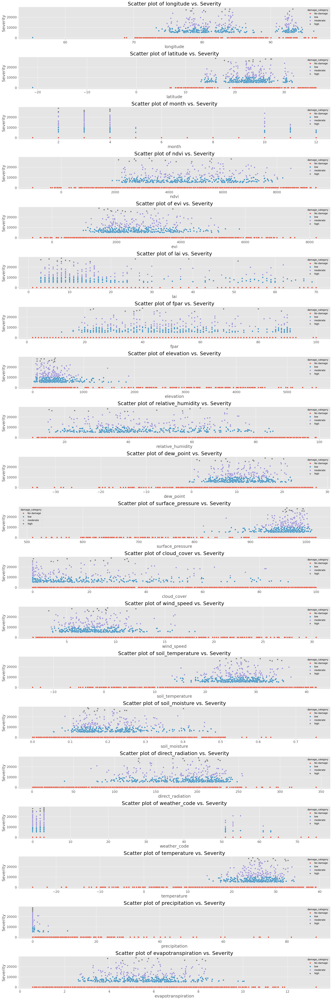

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Adjust figure size as needed (increase height, keep width the same)
plt.figure(figsize=(20, 60))  # Increased height to 60

# Calculate number of rows needed for the subplots
num_rows = len(num_data)  # Change this based on the actual length of num_data

# Use a dynamic grid size (adjust rows and columns)
for i, col in enumerate(num_data, 1):
    plt.subplot(num_rows, 1, i)  # Set the number of rows to the length of num_data

    if col in ['X', 'Y']:
        sns.swarmplot(data=data_no_dup, x=col, y='severity', hue='damage_category')
    else:
        sns.scatterplot(data=data_no_dup, x=col, y='severity', hue='damage_category')

    # Increase font size for title and axis labels
    plt.title(f'Scatter plot of {col} vs. Severity', fontsize=22)
    plt.xlabel(col, fontsize=18)
    plt.ylabel('Severity', fontsize=18)

    # Increase font size of tick labels
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)

# Adjust layout to prevent overlap
plt.tight_layout()

# Save the figure before showing it
plt.savefig('./severity_scatterplot.png')

# Show the plot
plt.show()


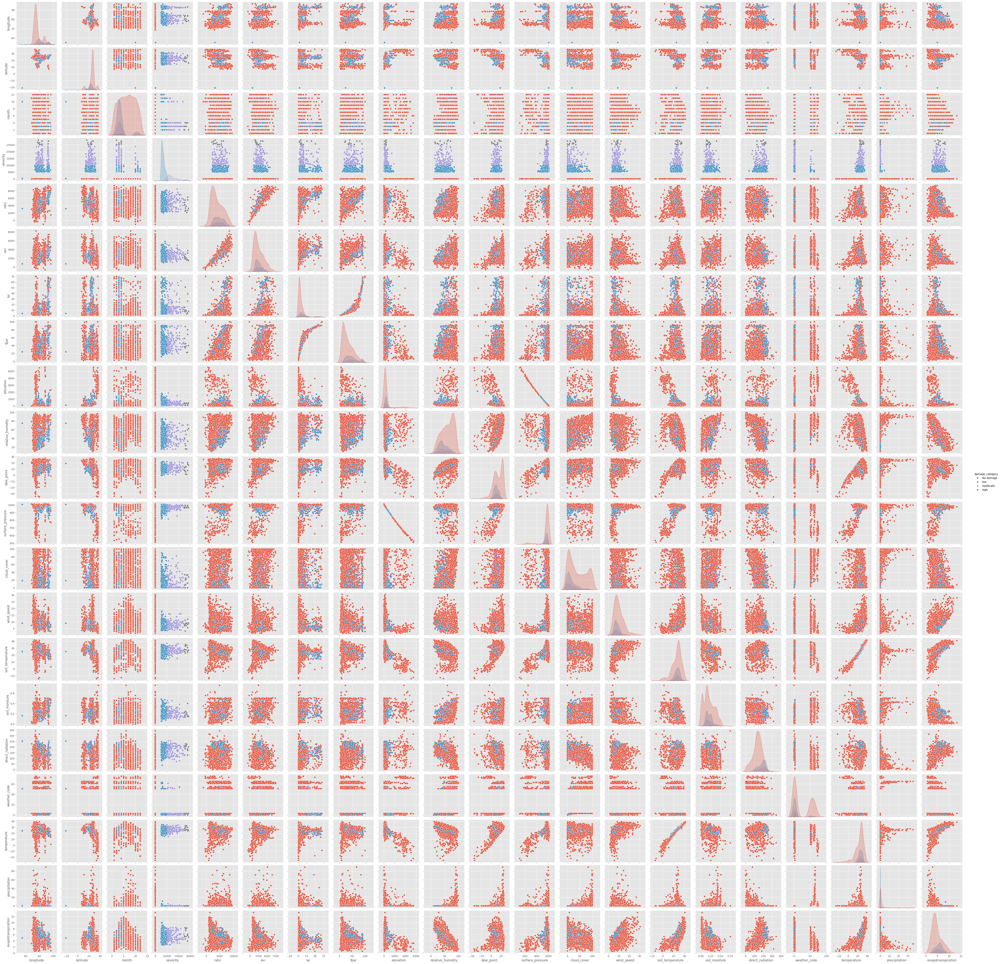

In [ ]:
selected_features = data_no_dup.drop(columns = ['damage_category','log-area']).columns
sns.pairplot(data_no_dup, hue = 'damage_category', vars = selected_features)
plt.show()

In [ ]:
out_columns = ['precipitation','severity']
df = pd.get_dummies(data_no_dup, columns=[], drop_first = True)

print(np.log1p(df[out_columns]).skew())
print('-'*20)
print(np.log1p(df[out_columns]).kurtosis())

precipitation    2.135515
severity         1.218746
dtype: float64
--------------------
precipitation    3.810212
severity        -0.495471
dtype: float64


In [ ]:
df[out_columns] = np.log1p(df[out_columns])
df[out_columns].skew()

,0
precipitation,2.135515
severity,1.218746


In [ ]:
df_ml = df.drop(columns = ['damage_category']).copy()
df_ml.head()

,longitude,latitude,month,severity,ndvi,evi,lai,fpar,elevation,relative_humidity,...,cloud_cover,wind_speed,soil_temperature,soil_moisture,direct_radiation,weather_code,temperature,precipitation,evapotranspiration,log-area
0,71.550597,24.871731,9,0.000000,5985,4295,17,63,28.0,71.660515,...,64.208336,6.318307,31.577667,0.103583,151.916672,3.0,30.136002,0.0,4.533731,0.000000
1,75.363980,13.461610,1,0.000000,8446,3742,54,89,762.0,61.519329,...,22.541666,6.720856,21.440001,0.365833,222.833328,3.0,21.244167,0.0,4.697797,0.000000
2,83.352281,23.738874,3,9.135725,4895,2702,13,45,526.0,33.725258,...,19.625000,7.875883,28.299250,0.152042,154.500000,3.0,27.895081,0.0,5.897649,3.967595
3,74.730360,28.394917,3,0.000000,1981,1293,2,16,268.0,66.151947,...,18.875000,11.952470,22.927500,0.033458,166.791672,3.0,19.212919,0.0,4.288070,0.000000
4,74.356150,22.621312,2,0.000000,2919,1308,4,25,452.0,50.998199,...,1.583333,8.598405,20.871416,0.326750,188.000000,1.0,21.644333,0.0,4.581380,0.000000


In [ ]:
inputs = df_ml.drop(['severity', 'log-area'], axis = 1)
target = df_ml['log-area']
inputs.shape

(1955, 20)

In [ ]:
from sklearn.model_selection import train_test_split
x_train , x_test, y_train, y_test = train_test_split(inputs, target, test_size = 0.1)
x_train.shape, x_test.shape

((1759, 20), (196, 20))

In [ ]:
def rec(m, n, tol):
    if type(m) != 'numpy.ndarray':
        m = np.array(m)
    if type(n) != 'numpy.ndarray':
        n = np.array(n)

    l = m.size
    percent = 0
    for i in range(l):
        if np.abs(10 ** m[i] - 10 ** n[i]) <= tol:
            percent += 1
    return 100 * (percent / l)

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV

params = {
    'max_depth': [5, 10, 15, 20, 50], 'max_leaf_nodes': [2, 5, 10], 'min_samples_leaf': [2, 5, 10],
    'min_samples_split':[2, 5, 10]
}
grid_rf = GridSearchCV(RandomForestRegressor(), param_grid = params, refit = True, verbose = 0, cv = 5)
grid_rf.fit(x_train, y_train)

In [ ]:
print("Best parameters obtained by Grid Search:",grid_rf.best_params_)

In [ ]:
from sklearn.metrics import mean_squared_error

a = grid_rf.predict(x_test)
print("RMSE for Random Forest:",  np.sqrt(mean_squared_error(y_test, a)))

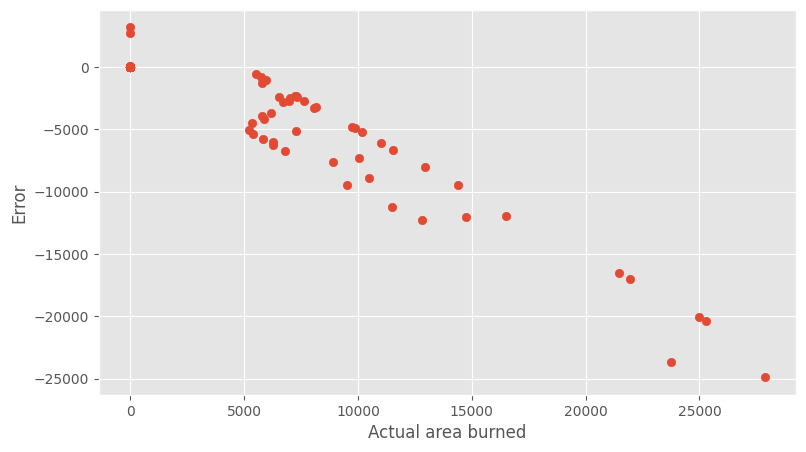

In [ ]:
plt.xlabel("Actual area burned")
plt.ylabel("Error")
plt.grid(True)
plt.scatter(10 ** (y_test), 10 ** (a) - 10 ** (y_test))

In [ ]:
rec_RF=[]
for i in range(20):
    rec_RF.append(rec(a, y_test, i))

plt.figure(figsize=(5,5))
plt.title("REC curve for the Random Forest\n",fontsize = 15)
plt.xlabel("Absolute error (tolerance) in prediction ($ha$)")
plt.ylabel("Percentage of correct prediction")
plt.xticks([i for i in range(0, 20 + 1, 5)])
plt.ylim(-10, 100)
plt.yticks([i * 20 for i in range(6)])
plt.grid(True)
plt.plot(range(20), rec_RF)

In [ ]:
from sklearn.metrics import accuracy_score
import numpy as np

y_pred = grid_rf.predict(x_test)

y_test_class = (y_test > 1).astype(int)
y_pred_class = (y_pred > 1).astype(int)

# Now compute the accuracy
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_test_class, y_pred_class)
print(f'Accuracy: {accuracy:.4f}')
print(f'Accuracy: {accuracy:.4f}')

In [ ]:
from sklearn.linear_model import LinearRegression
lm = LinearRegression()
lm.fit(x_train, y_train)

In [ ]:
y_pred = lm.predict(x_test)
print('RMSE for Linear Regression: ',np.sqrt(mean_squared_error(y_test, y_pred)))

In [ ]:
mean_squared_error(y_test, y_pred)

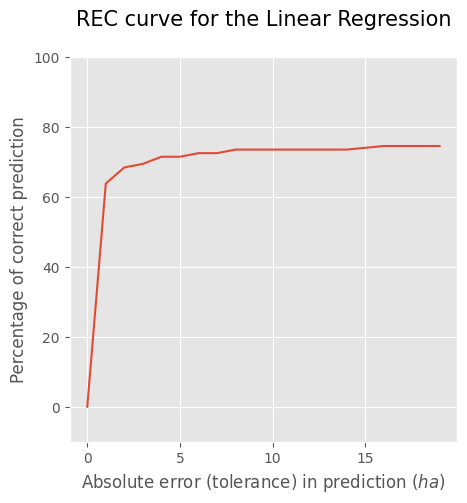

In [ ]:
rec_lm=[]
for i in range(20):
    rec_lm.append(rec(y_pred, y_test, i))

plt.figure(figsize=(5 ,5))
plt.title("REC curve for the Linear Regression\n",fontsize = 15)
plt.xlabel("Absolute error (tolerance) in prediction ($ha$)")
plt.ylabel("Percentage of correct prediction")
plt.xticks([i for i in range(0, 20 + 1, 5)])
plt.ylim(-10, 100)
plt.yticks([i * 20 for i in range(6)])
plt.grid(True)
plt.plot(range(20), rec_RF)

In [ ]:
y_pred = lm.predict(x_test)

y_test_class = (y_test > 1).astype(int)
y_pred_class = (y_pred > 1).astype(int)

# Now compute the accuracy
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_test_class, y_pred_class)
print(f'Accuracy: {accuracy:.4f}')
print(f'Accuracy: {accuracy:.4f}')

In [ ]:
import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow import keras

In [ ]:
model = Sequential([
    keras.layers.Dense(100, input_dim = 20, activation = 'relu'),
    keras.layers.Dense(150, activation = 'relu'),
    keras.layers.Dense(150, activation = 'relu'),
    keras.layers.Dense(150, activation = 'relu'),
    keras.layers.Dense(150, activation = 'relu'),
    keras.layers.Dropout(0.3),
    keras.layers.Dense(100, activation = 'relu'),
    keras.layers.Dense(100, activation = 'relu'),
    keras.layers.Dropout(0.3),
    keras.layers.Dense(50, activation = 'relu'),
    keras.layers.Dense(1)
])
model.summary()

In [ ]:
model.compile(optimizer = keras.optimizers.Adam(learning_rate = 0.001), loss = keras.losses.MeanSquaredError())
model.fit(inputs, target, epochs = 200, batch_size = 10)

In [ ]:
np.sqrt(mean_squared_error(y_test, model.predict(x_test)))

In [ ]:
print(model.predict(x_test)[:3])
print(y_test[:3])

In [ ]:
rec_NN=[]
for i in range(20):
    rec_NN.append(rec(model.predict(x_test), y_test,i))
plt.figure(figsize=(5,5))
plt.title("REC curve for Neural Network\n",fontsize=16)
plt.xlabel("Absolute error (tolerance) in prediction ($ha$)")
plt.ylabel("Percentage of correct prediction")
plt.xticks([i for i in range(0,20+1,5)])
plt.ylim(-10,100)
plt.yticks([i*20 for i in range(6)])
plt.grid(True)
plt.plot(range(20),rec_NN)

In [ ]:
y_pred = model.predict(x_test)

y_test_class = (y_test > 1).astype(int)
y_pred_class = (y_pred > 1).astype(int)

# Now compute the accuracy
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_test_class, y_pred_class)
print(f'Accuracy: {accuracy:.4f}')
print(f'Accuracy: {accuracy:.4f}')

In [ ]:
plt.figure(figsize=(10, 8))
plt.title("REC curve for RFR and NN\n",fontsize = 20)
plt.xlabel("Absolute error (tolerance) in prediction ($ha$)",fontsize = 15)
plt.ylabel("Percentage of correct prediction",fontsize=15)
plt.xticks([i for i in range(0,20+1,1)],fontsize=13)
plt.ylim(-10,100)
plt.xlim(-2,20)
plt.yticks([i*20 for i in range(6)],fontsize=18)
plt.grid(True)
plt.plot(range(20),rec_RF,'--',lw=3)
plt.plot(range(20),rec_NN,'-',lw=3)
plt.legend(['Random Forest','NN'],fontsize=13)

In [ ]:
from xgboost import XGBRegressor
xgb_model = XGBRegressor(n_estimators = 100, learning_rate = 0.1, booster = 'gbtree',
                         verbosity = 0, nthread = -1,
                          random_state = 1337)
params = {
    'min_child_weight': [None, 1, 5, 10],
    'gamma': [None, 0.1, 1, 5],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0],
    'max_depth': [1, 2, 3, 4, 5]
}
gs_xg = GridSearchCV(xgb_model , param_grid = params, n_jobs = -1, cv = 5,
                  verbose = 0)
gs_xg.fit(x_train, y_train)

In [ ]:
gs_xg.best_params_

In [ ]:
rec_gs_xg=[]
for i in range(20):
    rec_gs_xg.append(rec(gs_xg.predict(x_test), y_test,i))
plt.figure(figsize=(5,5))
plt.title("REC curve for XGBRegressor",fontsize=16)
plt.xlabel("Absolute error (tolerance) in prediction ($ha$)")
plt.ylabel("Percentage of correct prediction")
plt.xticks([i for i in range(0,20+1,5)])
plt.ylim(-10,100)
plt.yticks([i*20 for i in range(6)])
plt.grid(True)
plt.plot(range(20),rec_gs_xg)

In [ ]:
y_pred = gs_xg.predict(x_test)

y_test_class = (y_test > 1).astype(int)
y_pred_class = (y_pred > 1).astype(int)

# Now compute the accuracy
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_test_class, y_pred_class)
print(f'Accuracy: {accuracy:.4f}')
print(f'Accuracy: {accuracy:.4f}')

In [ ]:
# Plotting y_pred vs y_actual
plt.figure(figsize=(8, 6))

# Scatter plot with y_pred on x-axis and y_actual on y-axis
plt.scatter(y_pred, y_test, alpha=0.6, color='b', label='Predicted vs Actual')

# Adding labels and title
plt.xlabel('Predicted Values (y_pred)')
plt.ylabel('Actual Values (y_test)')
plt.title('Scatter Plot of Predicted vs Actual Values')

# Show a diagonal line where y_pred equals y_actual for reference
plt.plot([min(y_pred), max(y_pred)], [min(y_pred), max(y_pred)], color='r', linestyle='--', label='Perfect Prediction')

# Adding legend
plt.legend()

# Show the plot
plt.show()